# KVALITET PODATAKA - DATA QUALITY

#### Ovaj Jupyter notebook je deo seminarskog rada iz predmeta Predobrada i preprocesiranje podataka za mašinsko učenje kao praktični deo seminarskog rada

#### U njemu će biti predstavljeni praktični primeri na temu kvaliteta podataka što podrazumeva:

    - mere kvaliteta podataka
    - raspodelu podataka
    - korelaciju
    - varijansu 


In [46]:
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
import numpy as np
from sklearn.preprocessing import OneHotEncoder
from imblearn.over_sampling import SMOTE
from sklearn import preprocessing
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score, recall_score, precision_score, roc_curve, auc


In [170]:
data_project1 = pd.read_csv("data/ML_Project1 - Metro_Interstate_Traffic_Volume.csv")

In [5]:
data_project1.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,None,288.28,0.0,0.0,40,Clouds,scattered clouds,2012-10-02 09:00:00,5545
1,None,289.36,0.0,0.0,75,Clouds,broken clouds,2012-10-02 10:00:00,4516
2,None,289.58,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 11:00:00,4767
3,None,290.13,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 12:00:00,5026
4,None,291.14,0.0,0.0,75,Clouds,broken clouds,2012-10-02 13:00:00,4918


In [95]:
data_project1.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48204 entries, 0 to 48203
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   holiday              48204 non-null  object 
 1   temp                 48204 non-null  float64
 2   rain_1h              48204 non-null  float64
 3   snow_1h              48204 non-null  float64
 4   clouds_all           48204 non-null  int64  
 5   weather_main         48204 non-null  object 
 6   weather_description  48204 non-null  object 
 7   date_time            48204 non-null  object 
 8   traffic_volume       48204 non-null  int64  
dtypes: float64(3), int64(2), object(4)
memory usage: 3.3+ MB


In [96]:
data_project1.isna().sum()

holiday                0
temp                   0
rain_1h                0
snow_1h                0
clouds_all             0
weather_main           0
weather_description    0
date_time              0
traffic_volume         0
dtype: int64

## Korišćenjem pandas, seaborn i matplotlib metoda

In [6]:
data_project1.describe()

,temp,rain_1h,snow_1h,clouds_all,traffic_volume
count,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000
mean,281.205870,0.334264,0.000222,49.362231,3259.818355
std,13.338232,44.789133,0.008168,39.015750,1986.860670
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,272.160000,0.000000,0.000000,1.000000,1193.000000
50%,282.450000,0.000000,0.000000,64.000000,3380.000000
75%,291.806000,0.000000,0.000000,90.000000,4933.000000
max,310.070000,9831.300000,0.510000,100.000000,7280.000000


### Mere centralne tendencije

In [7]:
data_project1.mean(numeric_only=True)

temp               281.205870
rain_1h              0.334264
snow_1h              0.000222
clouds_all          49.362231
traffic_volume    3259.818355
dtype: float64

In [8]:
data_project1.median(numeric_only=True)

temp               282.45
rain_1h              0.00
snow_1h              0.00
clouds_all          64.00
traffic_volume    3380.00
dtype: float64

In [9]:
data_project1.mode(axis=0).head(1)

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,None,274.15,0.0,0.0,90.0,Clouds,sky is clear,2013-04-18 22:00:00,353


## Raspodela podataka

#### Traffic_volume atribut

<AxesSubplot:ylabel='Frequency'>

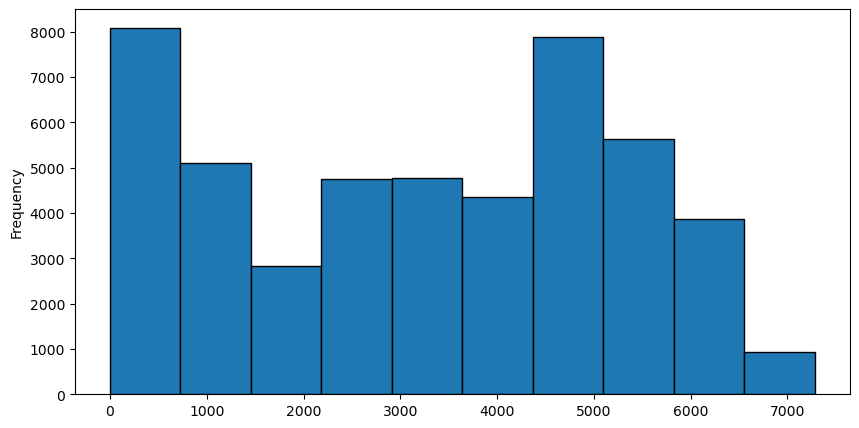

In [10]:
data_project1['traffic_volume'].plot(kind='hist', edgecolor='black', figsize=(10,5))


<AxesSubplot:xlabel='traffic_volume', ylabel='Count'>

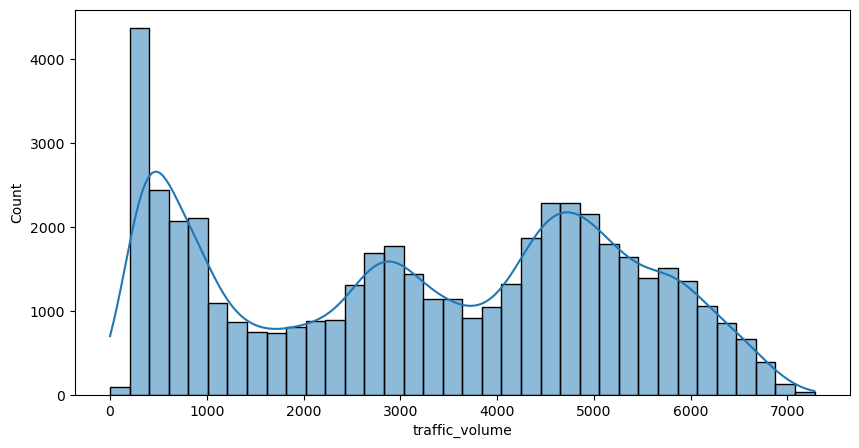

In [11]:
plt.figure(figsize=(10,5))
sns.histplot(data_project1['traffic_volume'], kde=True)

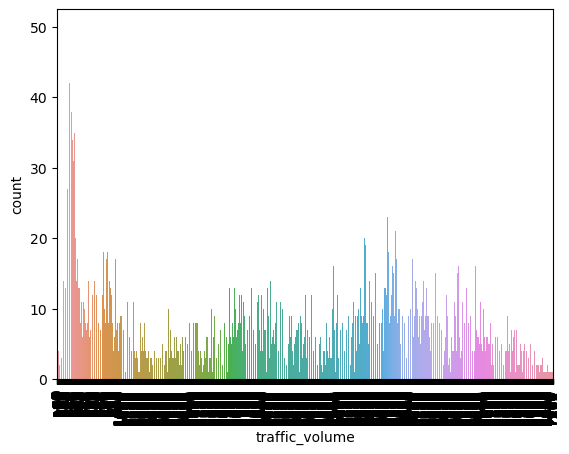

In [12]:
sns.countplot(x = "traffic_volume", data = data_project1)
#plt.figure(figsize=(10,5))
plt.xticks(rotation='vertical')

plt.show()

<AxesSubplot:ylabel='Density'>

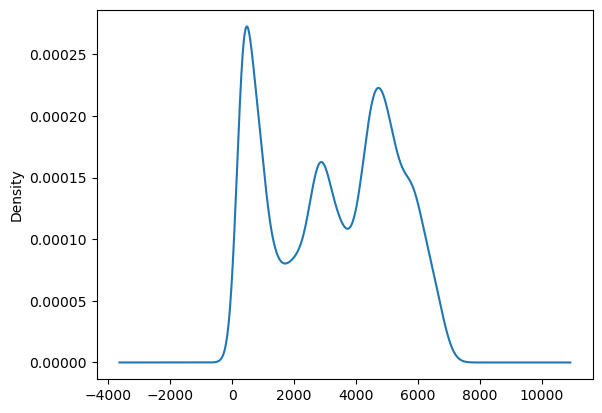

In [13]:
data_project1['traffic_volume'].plot(kind='density')#.set_xlim(-1000,8000)


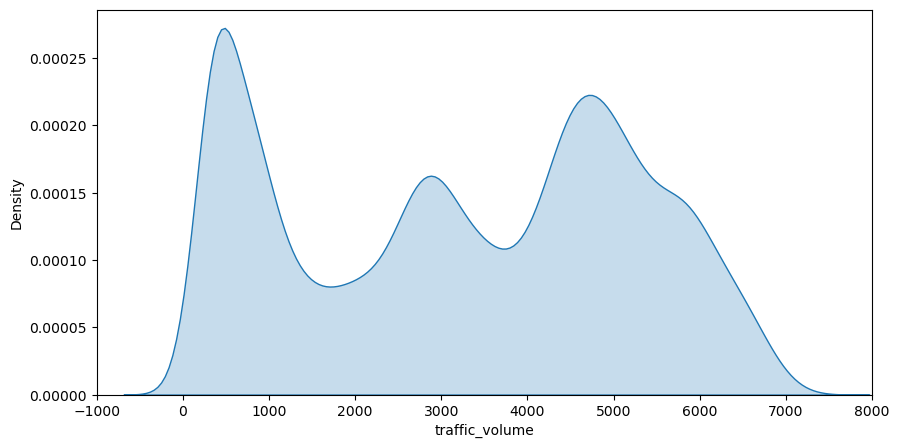

In [14]:
plt.figure(figsize=(10,5))
plt.xlim(-1000,8000)
plt.xlabel('traffic_volume')
plt.ylabel('Density')
sns.kdeplot(data_project1['traffic_volume'],shade=True)
plt.show()

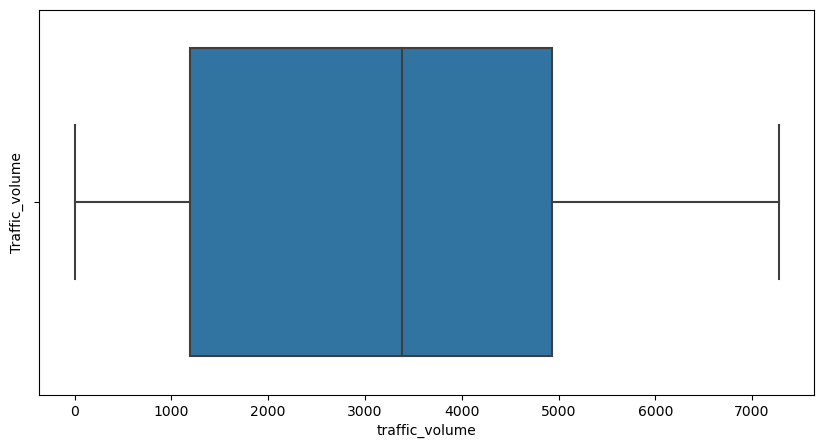

In [15]:
plt.figure(figsize=(10,5))
#plt.xlim(0,1000)
plt.ylabel('Traffic_volume')
sns.boxplot(x=data_project1['traffic_volume'])
plt.show()

#### PDF i CDF dijagrami

<AxesSubplot:xlabel='traffic_volume'>

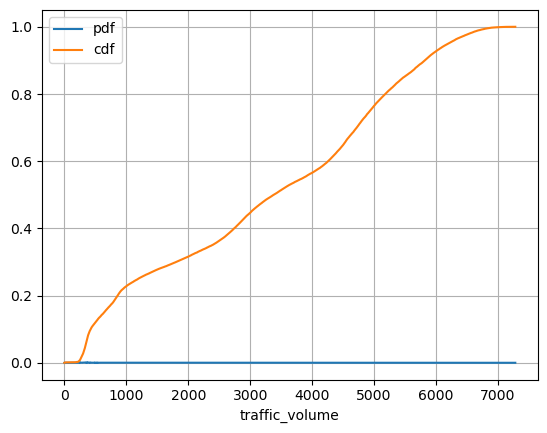

In [16]:
stats_df = data_project1 \
.groupby('traffic_volume') \
['traffic_volume'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'traffic_volume': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "traffic_volume",  y = ['pdf', 'cdf'], grid = True)


#### Temp atribut

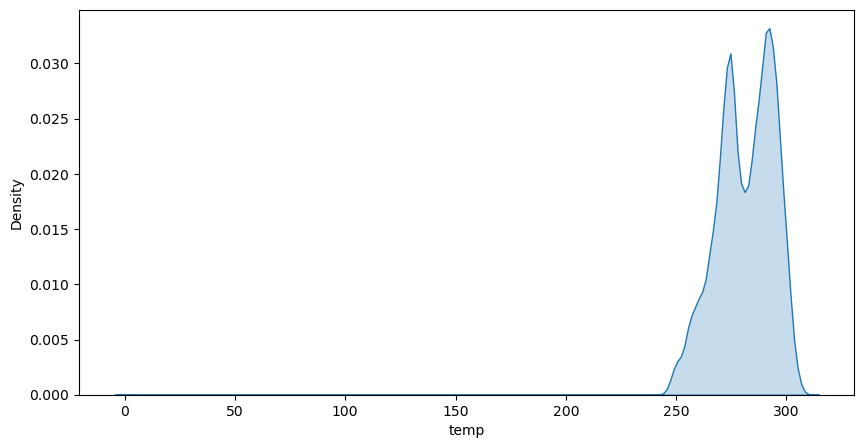

In [17]:
#data_project1['temp'].plot(kind='density')

plt.figure(figsize=(10,5))
# plt.xlim(-1000,8000)
plt.xlabel('temp')
plt.ylabel('Density')
sns.kdeplot(data_project1['temp'],shade=True)
plt.show()

### PROVERA OUTLIER-A

In [18]:
outlier_data = data_project1.loc[data_project1['temp']<240]
outlier_data.describe()

,temp,rain_1h,snow_1h,clouds_all,traffic_volume
count,10.0,10.0,10.0,10.0,10.000000
mean,0.0,0.0,0.0,0.0,1318.200000
std,0.0,0.0,0.0,0.0,1526.341727
min,0.0,0.0,0.0,0.0,284.000000
25%,0.0,0.0,0.0,0.0,379.250000
50%,0.0,0.0,0.0,0.0,736.500000
75%,0.0,0.0,0.0,0.0,1493.000000
max,0.0,0.0,0.0,0.0,5150.000000


In [19]:
outlier_data.head(10)

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
11898,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-01-31 03:00:00,361
11899,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-01-31 04:00:00,734
11900,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-01-31 05:00:00,2557
11901,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-01-31 06:00:00,5150
11946,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 03:00:00,291
11947,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 04:00:00,284
11948,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 05:00:00,434
11949,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 06:00:00,739
11950,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 07:00:00,962
11951,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 08:00:00,1670


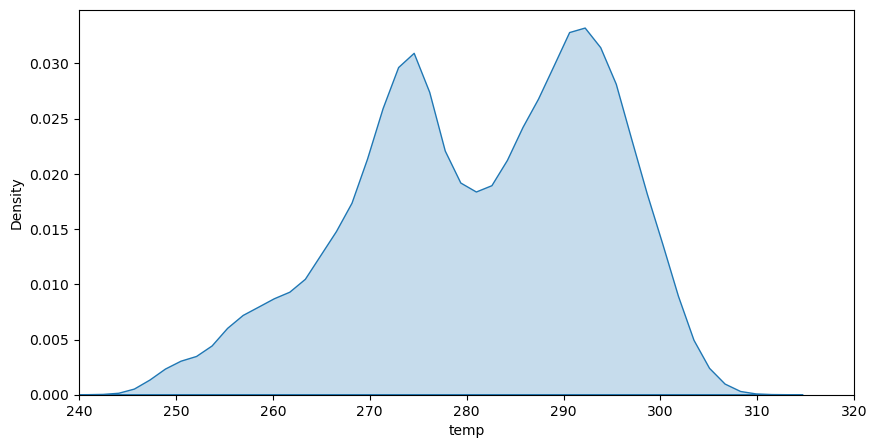

In [20]:
plt.figure(figsize=(10,5))
plt.xlim(240,320)
plt.xlabel('temp')
plt.ylabel('Density')
sns.kdeplot(data_project1['temp'],shade=True)
plt.show()

#### PDF i CDF grafici

<AxesSubplot:xlabel='temp'>

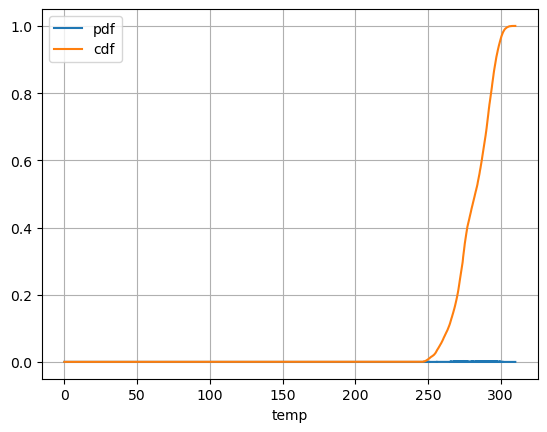

In [21]:
stats_df = data_project1 \
.groupby('temp') \
['temp'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'temp': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "temp",  y = ['pdf', 'cdf'], grid = True) #, xlim=(200,320))

#### Clouds All atribut sa tri vrha

<AxesSubplot:ylabel='Density'>

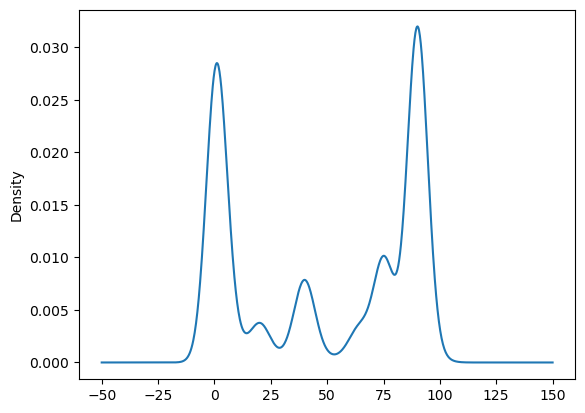

In [22]:
data_project1['clouds_all'].plot(kind='density')


#### Kategorički atributi

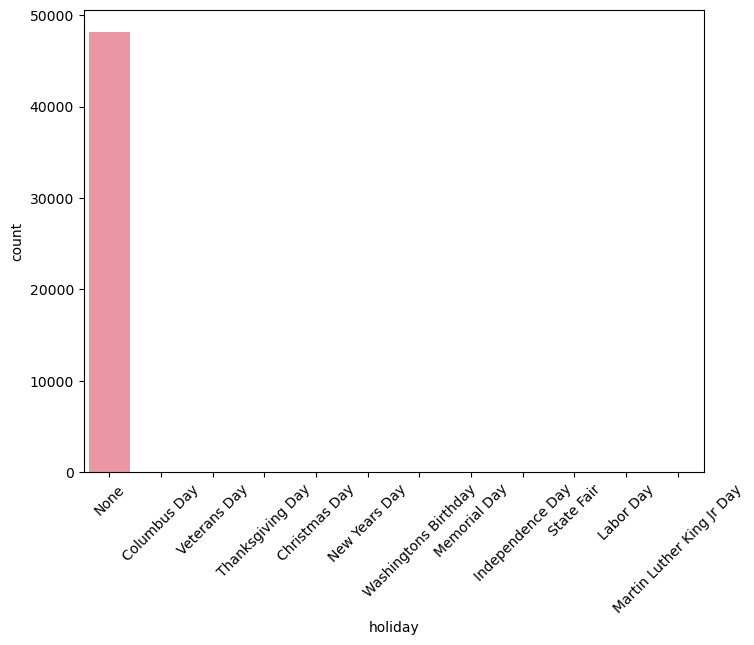

In [23]:
plt.figure(figsize=(8,6))
sns.countplot(x='holiday', data= data_project1)
plt.xticks(rotation=45)
plt.show()

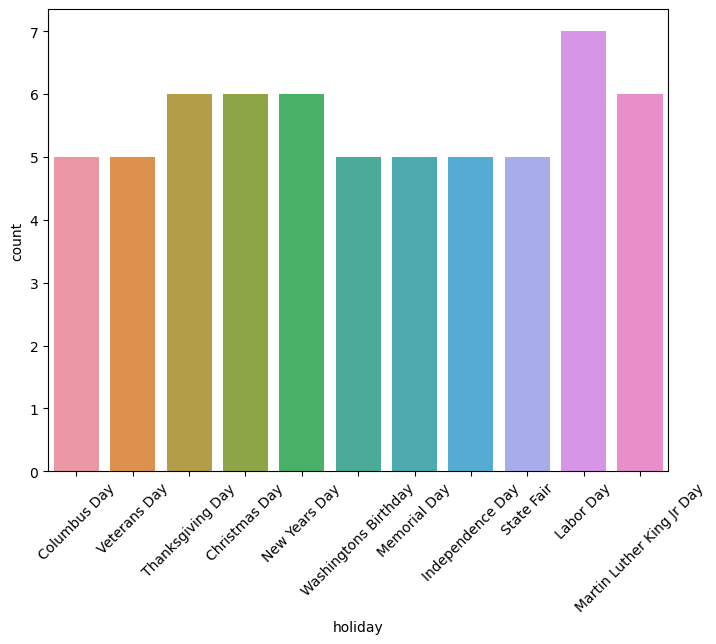

In [24]:
holidays = data_project1.loc[data_project1['holiday'] != 'None']
plt.figure(figsize=(8,6))
sns.countplot(x='holiday', data= holidays)
plt.xticks(rotation=45)
plt.show()

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

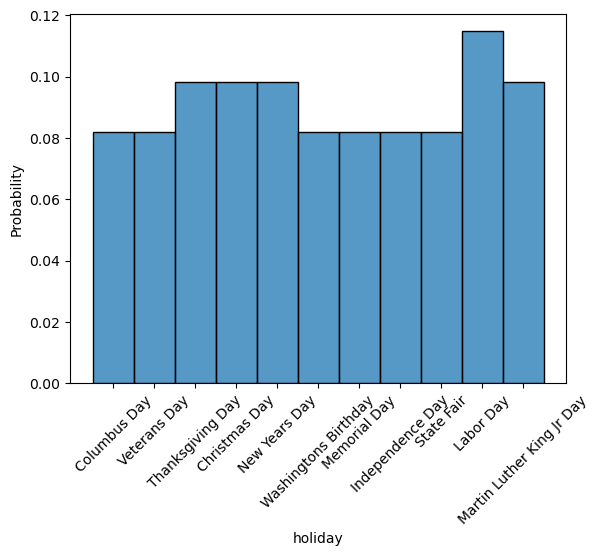

In [25]:
holiday_data = data_project1.loc[data_project1['holiday'] != 'None']['holiday']
sns.histplot(holiday_data, stat='probability')
plt.xticks(rotation=45)

<AxesSubplot:xlabel='count', ylabel='weather_main'>

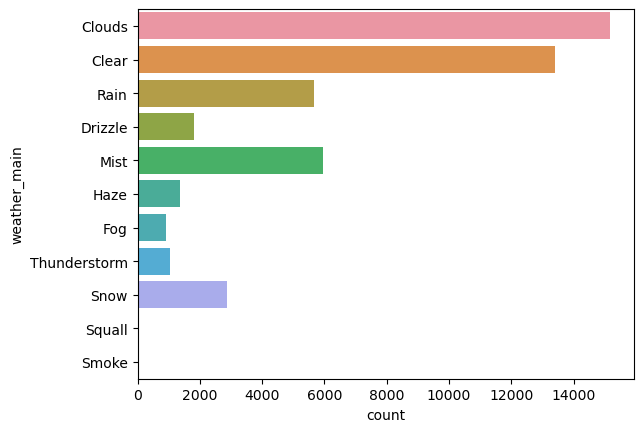

In [26]:
sns.countplot(y='weather_main', data=data_project1)

## Matrica korelacije

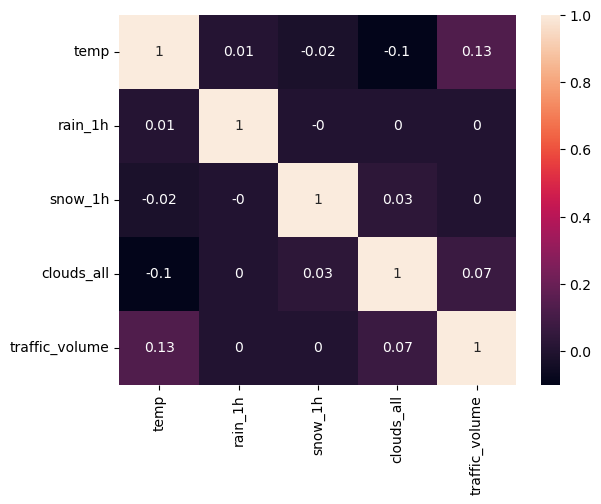

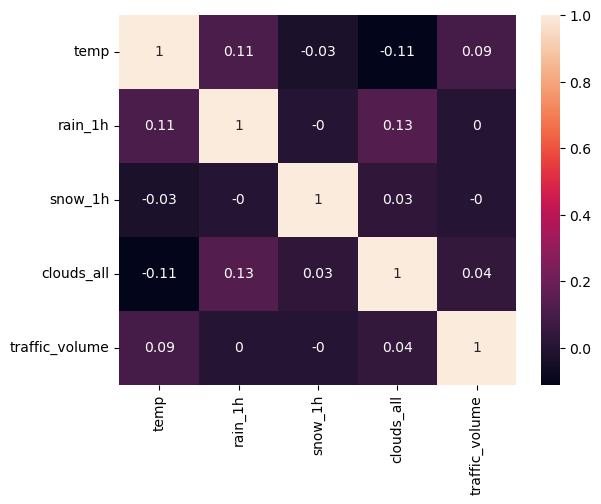

In [27]:
matrix = data_project1.corr(method='pearson').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

matrix = data_project1.corr(method='kendall').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

## Varijansa i standardna devijacija

In [28]:
data_project1.var(numeric_only=True).round(2)

temp                  177.91
rain_1h              2006.07
snow_1h                 0.00
clouds_all           1522.23
traffic_volume    3947615.32
dtype: float64

In [29]:
data_project1.std(numeric_only=True).round(2)

temp                13.34
rain_1h             44.79
snow_1h              0.01
clouds_all          39.02
traffic_volume    1986.86
dtype: float64

#### Korišćenjem ProfileReport klase

In [30]:
project1_report = ProfileReport(data_project1)

#### EDA analiza Projekta 1

In [31]:
project1_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### UTICAJ RASPODELE PODATAKA I ZAVISNOSTI IZMEĐU PODATAKA NA REZULTATE ALGORITAMA MAŠINSKOG UČENJA

#### Pretprocesiranje skupa podataka

In [127]:
data_project1.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,None,288.28,0.0,0.0,40,Clouds,scattered clouds,2012-10-02 09:00:00,5545
1,None,289.36,0.0,0.0,75,Clouds,broken clouds,2012-10-02 10:00:00,4516
2,None,289.58,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 11:00:00,4767
3,None,290.13,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 12:00:00,5026
4,None,291.14,0.0,0.0,75,Clouds,broken clouds,2012-10-02 13:00:00,4918


In [171]:
data_project1.drop(columns = ['date_time', "weather_description"],inplace = True)

In [172]:
data_project1.loc[data_project1['weather_main'].str.contains('Haze'),'weather_main'] = 'Fog'   
data_project1.loc[data_project1['weather_main'].str.contains('Mist'),'weather_main'] = 'Fog'   
data_project1.loc[data_project1['weather_main'].str.contains('Smoke'),'weather_main'] = 'Fog'   
data_project1.loc[data_project1['weather_main'].str.contains('Squall'),'weather_main'] = 'Thunderstorm'       
data_project1['weather_main'].value_counts()

Clouds          15164
Clear           13391
Fog              8242
Rain             5672
Snow             2876
Drizzle          1821
Thunderstorm     1038
Name: weather_main, dtype: int64

#### Enkodiranje kategoričkih vrednosti

In [173]:
from sklearn.preprocessing import OrdinalEncoder
enc = OrdinalEncoder()
data_project1["holiday"] = enc.fit_transform(data_project1[["holiday"]])

#data_project1[['holiday']] = ordinal_encoder.fit_transform(data_project1[['holiday']])


In [174]:
data_project1['weather_main'].value_counts()

Clouds          15164
Clear           13391
Fog              8242
Rain             5672
Snow             2876
Drizzle          1821
Thunderstorm     1038
Name: weather_main, dtype: int64

In [138]:
from sklearn.preprocessing import OneHotEncoder

OH_encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
OH_cols = pd.DataFrame(OH_encoder.fit_transform(data_project1[['weather_main']]))

# One-hot encoding removed index; put it back
OH_cols.index = data_project1.index
column_name = OH_encoder.get_feature_names_out(['weather_main'])
OH_cols.columns = column_name

# Remove categorical columns (will replace with one-hot encoding)
num_X = data_project1.drop(['weather_main'], axis=1)
OH_X = pd.concat([num_X, OH_cols], axis=1)
#one_hot_encoded_frame = pd.DataFrame.sparse.from_spmatrix(OH_X, columns= column_name)

data_project1=OH_X
OH_cols = pd.DataFrame(data_project1[['traffic_volume']])
num_X = data_project1.drop("traffic_volume", axis=1)
Odf_X = pd.concat([num_X, OH_cols], axis=1)
data_project1=Odf_X
data_project1.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
0,7.0,288.28,0.0,0.0,40,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5545
1,7.0,289.36,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4516
2,7.0,289.58,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4767
3,7.0,290.13,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5026
4,7.0,291.14,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4918


In [141]:
data_project1.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
0,7.0,288.28,0.0,0.0,40,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5545
1,7.0,289.36,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4516
2,7.0,289.58,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4767
3,7.0,290.13,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5026
4,7.0,291.14,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4918


#### Matrica korelacije osnovnog skupa

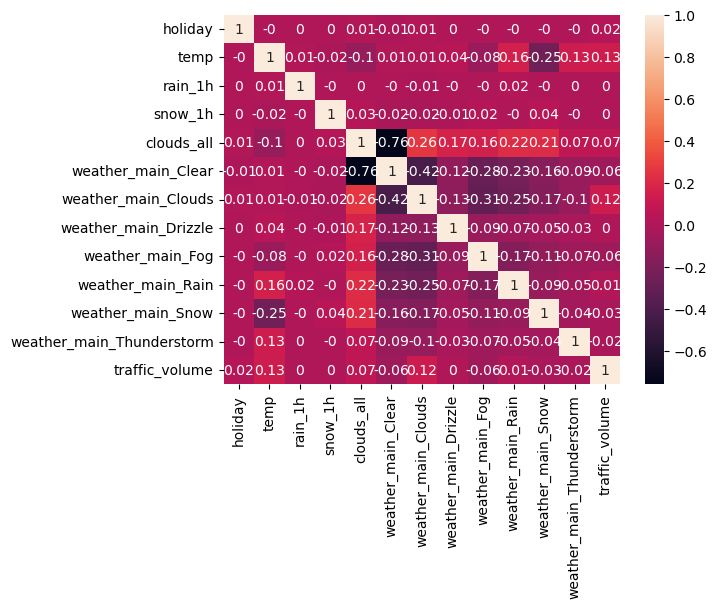

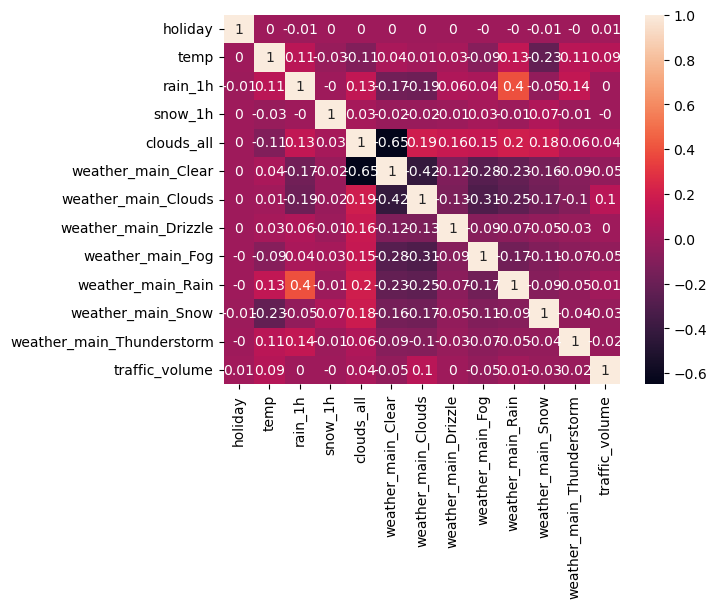

In [147]:
matrix = data_project1.corr(method='pearson').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

matrix = data_project1.corr(method='kendall').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

#### Filtrirani skup podataka

In [157]:
data_project1_filtered = data_project1.copy()
#data_project1_filtered.head()
data_project1_filtered.drop(columns = ['rain_1h','snow_1h', 'holiday', 'weather_main_Drizzle', 'weather_main_Thunderstorm', 'weather_main_Rain'],inplace = True)

In [149]:
data_project1.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
0,7.0,288.28,0.0,0.0,40,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5545
1,7.0,289.36,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4516
2,7.0,289.58,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4767
3,7.0,290.13,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5026
4,7.0,291.14,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4918


In [158]:
data_project1_filtered.head()

,temp,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Fog,weather_main_Snow,traffic_volume
0,288.28,40,0.0,1.0,0.0,0.0,5545
1,289.36,75,0.0,1.0,0.0,0.0,4516
2,289.58,90,0.0,1.0,0.0,0.0,4767
3,290.13,90,0.0,1.0,0.0,0.0,5026
4,291.14,75,0.0,1.0,0.0,0.0,4918


#### Matrica korelacije filtriranog skupa

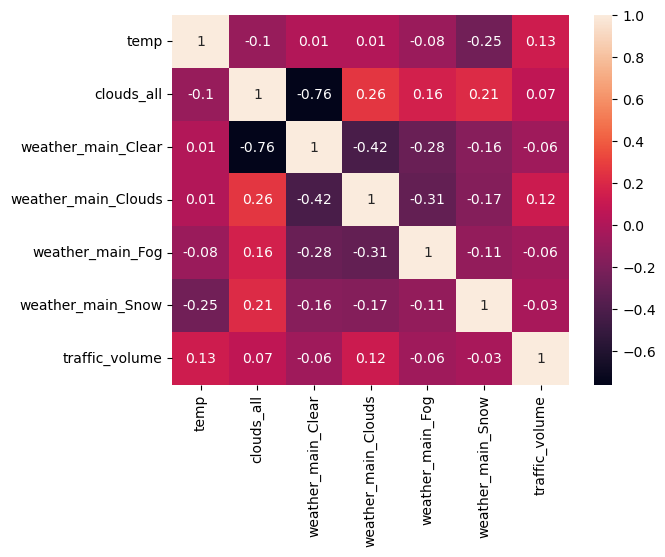

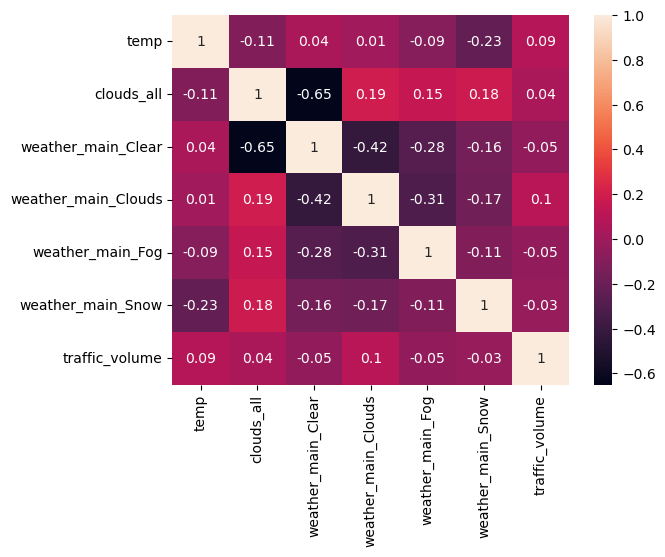

In [169]:
matrix = data_project1_filtered.corr(method='pearson').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

matrix = data_project1_filtered.corr(method='kendall').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

#### Train/Test podela filter skupa

In [159]:
labels = np.array(data_project1_filtered['traffic_volume'])
features= data_project1_filtered.drop('traffic_volume', axis = 1)

#saving names for later use
feature_list = list(features.columns)

# Convert to numpy array
features = np.array(features)

# Split the data into training and testing sets
train_features_filtered, test_features_filtered, train_labels_filtered, test_labels_filtered = train_test_split(features, labels, test_size = 0.25, random_state = 42)

print('Training Features Shape:', train_features_filtered.shape)
print('Training Labels Shape:', train_labels_filtered.shape)
print('Testing Features Shape:', test_features_filtered.shape)
print('Testing Labels Shape:', test_labels_filtered.shape)


Training Features Shape: (36153, 6)
Training Labels Shape: (36153,)
Testing Features Shape: (12051, 6)
Testing Labels Shape: (12051,)


#### Train/Test podela osnovnog skupa

In [160]:
labels = np.array(data_project1['traffic_volume'])
features= data_project1.drop('traffic_volume', axis = 1)

#saving names for later use
feature_list = list(features.columns)

# Convert to numpy array
features = np.array(features)

# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

Training Features Shape: (36153, 12)
Training Labels Shape: (36153,)
Testing Features Shape: (12051, 12)
Testing Labels Shape: (12051,)


In [161]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

def train_test_various_models(models, X_train, X_test, y_train, y_test):
    """trains and test given models on given data"""
    data_table=pd.DataFrame(columns=['model','r2_score training', 'r2_score test', 'MSE training', 'MSE test'])
    for model_name, model in models.items():
        model.fit(X_train, y_train)
        y_train_pred = model.predict(X_train)
        y_test_pred = model.predict(X_test)
        num_rows = data_table.shape[0]
        data_table.loc[num_rows+1] = [model_name, r2_score(y_train, y_train_pred),
         r2_score(y_test, y_test_pred),
          np.sqrt(mean_squared_error(y_train, y_train_pred)),
           np.sqrt(mean_squared_error(y_test, y_test_pred))]

    return data_table

In [162]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor      
from sklearn.tree import DecisionTreeRegressor

models = {
    'best_linear_regression_hyperparameters': LinearRegression(),
    'best random_forest_regressor_hyperparameters': RandomForestRegressor(max_depth=17, n_estimators=100, min_samples_leaf=10),
    'best decision_tree_regresor_hyperparameters': DecisionTreeRegressor(max_depth=15, min_samples_leaf=50),
}

results = train_test_various_models(models, train_features, test_features, train_labels, test_labels)
results.head()

,model,r2_score training,r2_score test,MSE training,MSE test
1,best_linear_regression_hyperparameters,0.036277,0.037868,1949.874442,1950.640162
2,best random_forest_regressor_hyperparameters,0.211165,0.101048,1764.100828,1885.506975
3,best decision_tree_regresor_hyperparameters,0.123180,0.070399,1859.883621,1917.379838


In [163]:
results_filtered = train_test_various_models(models, train_features_filtered, test_features_filtered, train_labels_filtered, test_labels_filtered)
results_filtered.head()

,model,r2_score training,r2_score test,MSE training,MSE test
1,best_linear_regression_hyperparameters,0.034807,0.037643,1951.360901,1950.867914
2,best random_forest_regressor_hyperparameters,0.209413,0.095460,1766.059502,1891.358273
3,best decision_tree_regresor_hyperparameters,0.125349,0.071919,1857.580951,1915.811896


### Razlika u rezultatu

In [168]:
result_difference = results.loc[:, results.columns != 'model'] - results_filtered.loc[:, results_filtered.columns != 'model']
result_difference['model'] = results['model']
result_difference.head()

,r2_score training,r2_score test,MSE training,MSE test,model
1,0.001470,0.000225,-1.486460,-0.227752,best_linear_regression_hyperparameters
2,0.001753,0.005588,-1.958674,-5.851298,best random_forest_regressor_hyperparameters
3,-0.002170,-0.001520,2.302670,1.567942,best decision_tree_regresor_hyperparameters


### ML PROJECT 2 

In [32]:
data_project2 = pd.read_csv("data/ML_Project2 - responses.csv")

In [33]:
data_project2.head()

,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,...,Age,Height,Weight,Number of siblings,Gender,Left - right handed,Education,Only child,Village - town,House - block of flats
0,5.0,3.0,2.0,1.0,2.0,2.0,1.0,5.0,5.0,1.0,...,20.0,163.0,48.0,1.0,female,right handed,college/bachelor degree,no,village,block of flats
1,4.0,4.0,2.0,1.0,1.0,1.0,2.0,3.0,5.0,4.0,...,19.0,163.0,58.0,2.0,female,right handed,college/bachelor degree,no,city,block of flats
2,5.0,5.0,2.0,2.0,3.0,4.0,5.0,3.0,5.0,3.0,...,20.0,176.0,67.0,2.0,female,right handed,secondary school,no,city,block of flats
3,5.0,3.0,2.0,1.0,1.0,1.0,1.0,2.0,2.0,1.0,...,22.0,172.0,59.0,1.0,female,right handed,college/bachelor degree,yes,city,house/bungalow
4,5.0,3.0,4.0,3.0,2.0,4.0,3.0,5.0,3.0,1.0,...,20.0,170.0,59.0,1.0,female,right handed,secondary school,no,village,house/bungalow


In [34]:
data_project2._get_numeric_data().columns

Index(['Music', 'Slow songs or fast songs', 'Dance', 'Folk', 'Country',
       'Classical music', 'Musical', 'Pop', 'Rock', 'Metal or Hardrock',
       ...
       'Shopping centres', 'Branded clothing', 'Entertainment spending',
       'Spending on looks', 'Spending on gadgets',
       'Spending on healthy eating', 'Age', 'Height', 'Weight',
       'Number of siblings'],
      dtype='object', length=139)

In [35]:
data_project2_object = data_project2.select_dtypes(include='object')
#print(data_project2_object.columns)

print("Broj unique vrednosti svakog kategoričkog atributa")
print(data_project2[data_project2_object.columns].nunique())

Broj unique vrednosti svakog kategoričkog atributa
Smoking                   4
Alcohol                   3
Punctuality               3
Lying                     4
Internet usage            4
Gender                    2
Left - right handed       2
Education                 6
Only child                2
Village - town            2
House - block of flats    2
dtype: int64


## Korišćenjem pandas, seaborn i matplotlib metoda

In [36]:
data_project2.describe()

,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,...,Shopping centres,Branded clothing,Entertainment spending,Spending on looks,Spending on gadgets,Spending on healthy eating,Age,Height,Weight,Number of siblings
count,1007.000000,1008.000000,1006.000000,1005.000000,1005.000000,1003.000000,1008.000000,1007.000000,1004.000000,1007.000000,...,1008.000000,1008.000000,1007.000000,1007.000000,1010.000000,1008.00000,1003.000000,990.000000,990.000000,1004.000000
mean,4.731877,3.328373,3.113320,2.288557,2.123383,2.956132,2.761905,3.471698,3.761952,2.361470,...,3.234127,3.050595,3.201589,3.106256,2.870297,3.55754,20.433699,173.514141,66.405051,1.297809
std,0.664049,0.833931,1.170568,1.138916,1.076136,1.252570,1.260845,1.161400,1.184861,1.372995,...,1.323062,1.306321,1.188947,1.205368,1.284970,1.09375,2.828840,10.024505,13.839561,1.013348
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,15.000000,62.000000,41.000000,0.000000
25%,5.000000,3.000000,2.000000,1.000000,1.000000,2.000000,2.000000,3.000000,3.000000,1.000000,...,2.000000,2.000000,2.000000,2.000000,2.000000,3.00000,19.000000,167.000000,55.000000,1.000000
50%,5.000000,3.000000,3.000000,2.000000,2.000000,3.000000,3.000000,4.000000,4.000000,2.000000,...,3.000000,3.000000,3.000000,3.000000,3.000000,4.00000,20.000000,173.000000,64.000000,1.000000
75%,5.000000,4.000000,4.000000,3.000000,3.000000,4.000000,4.000000,4.000000,5.000000,3.000000,...,4.000000,4.000000,4.000000,4.000000,4.000000,4.00000,22.000000,180.000000,75.000000,2.000000
max,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,...,5.000000,5.000000,5.000000,5.000000,5.000000,5.00000,30.000000,203.000000,165.000000,10.000000


### Mere centralne tendencije

In [37]:
data_project2.mean(numeric_only=True)

Music                           4.731877
Slow songs or fast songs        3.328373
Dance                           3.113320
Folk                            2.288557
Country                         2.123383
                                 ...    
Spending on healthy eating      3.557540
Age                            20.433699
Height                        173.514141
Weight                         66.405051
Number of siblings              1.297809
Length: 139, dtype: float64

In [38]:
data_project2.median(numeric_only=True)

Music                           5.0
Slow songs or fast songs        3.0
Dance                           3.0
Folk                            2.0
Country                         2.0
                              ...  
Spending on healthy eating      4.0
Age                            20.0
Height                        173.0
Weight                         64.0
Number of siblings              1.0
Length: 139, dtype: float64

In [39]:
data_project2.mode(axis=0).head(1)

,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,...,Age,Height,Weight,Number of siblings,Gender,Left - right handed,Education,Only child,Village - town,House - block of flats
0,5.0,3.0,3.0,2.0,2.0,3.0,3.0,4.0,5.0,1.0,...,19.0,170.0,60.0,1.0,female,right handed,secondary school,no,city,block of flats


## Raspodela podataka

#### Age atribut

<AxesSubplot:xlabel='Age', ylabel='Count'>

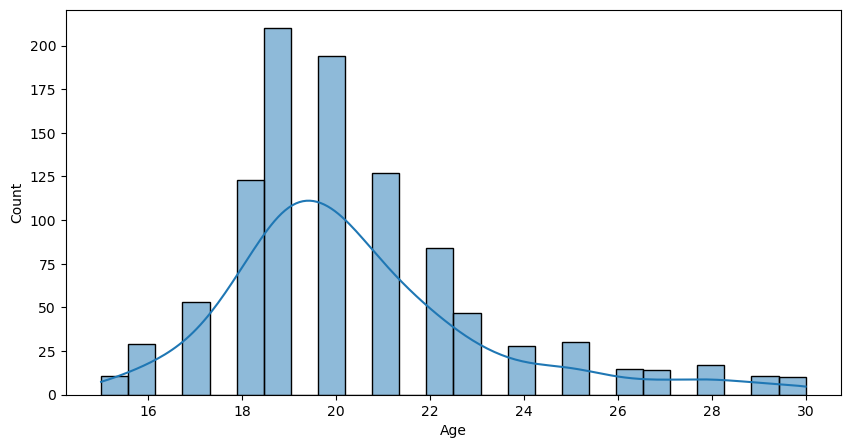

In [40]:
plt.figure(figsize=(10,5))
sns.histplot(data_project2['Age'], kde=True)

<AxesSubplot:xlabel='Age'>

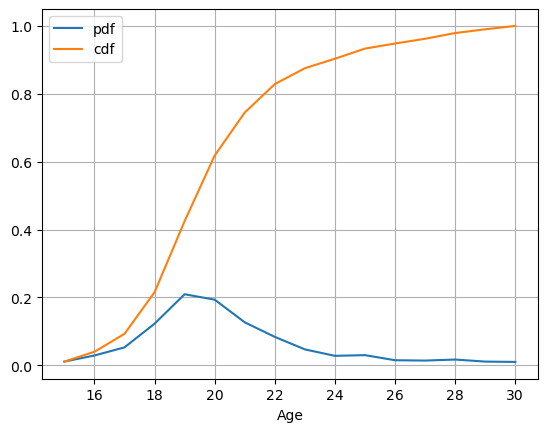

In [41]:
stats_df = data_project2 \
.groupby('Age') \
['Age'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'Age': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "Age",  y = ['pdf', 'cdf'], grid = True)

#### Height atribut

<AxesSubplot:xlabel='Height', ylabel='Count'>

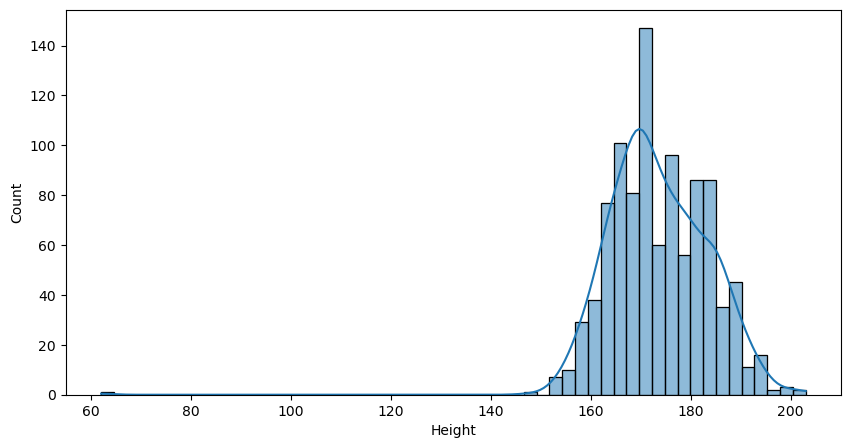

In [42]:
plt.figure(figsize=(10,5))
sns.histplot(data_project2['Height'], kde=True)

<AxesSubplot:xlabel='Height'>

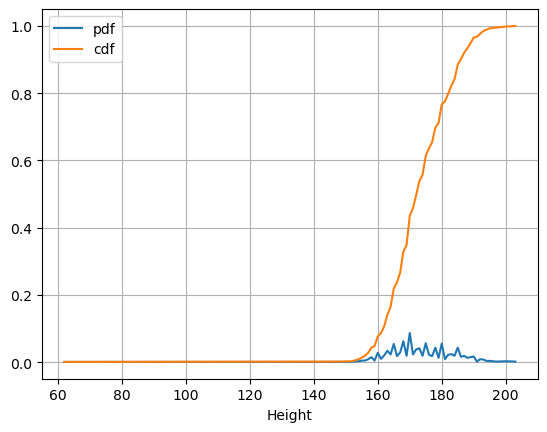

In [43]:
stats_df = data_project2 \
.groupby('Height') \
['Height'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'Height': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "Height",  y = ['pdf', 'cdf'], grid = True)

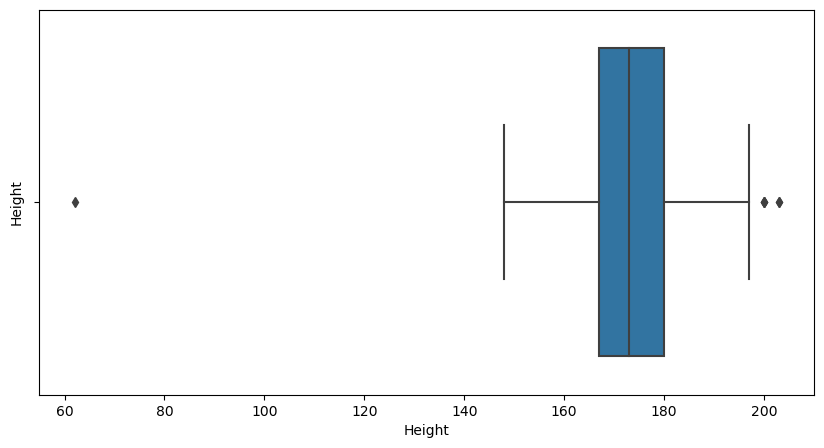

In [44]:
plt.figure(figsize=(10,5))
#plt.xlim(0,1000)
plt.ylabel('Height')
sns.boxplot(x=data_project2['Height'])
plt.show()

#### Weight atribut

<AxesSubplot:xlabel='Weight', ylabel='Count'>

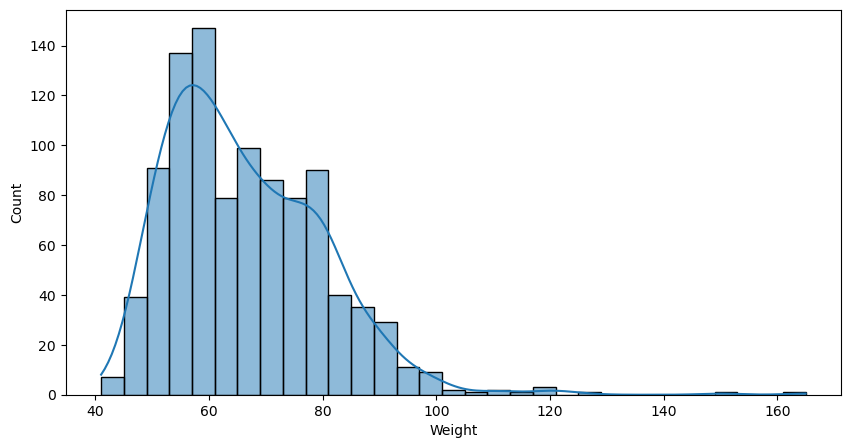

In [45]:
plt.figure(figsize=(10,5))
sns.histplot(data_project2['Weight'], kde=True)

<AxesSubplot:xlabel='Weight'>

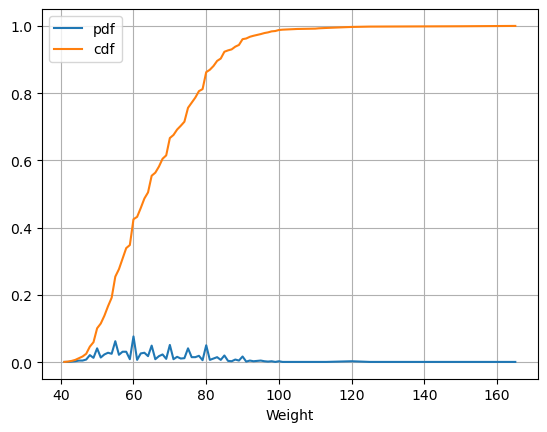

In [46]:
stats_df = data_project2 \
.groupby('Weight') \
['Weight'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'Weight': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "Weight",  y = ['pdf', 'cdf'], grid = True)

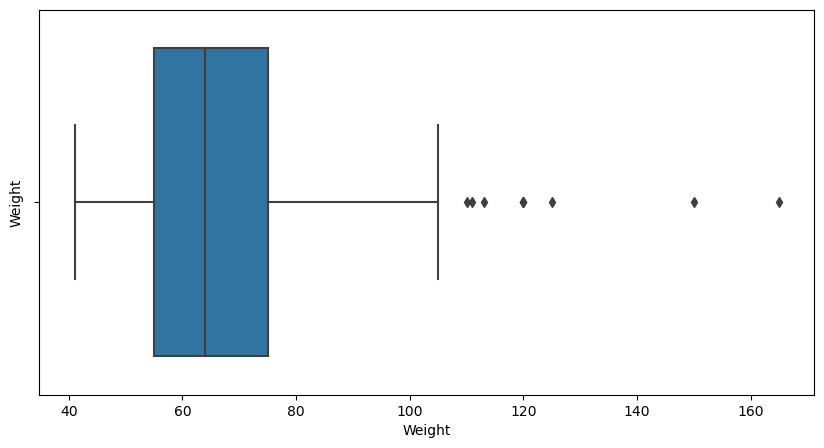

In [47]:
plt.figure(figsize=(10,5))
#plt.xlim(0,1000)
plt.ylabel('Weight')
sns.boxplot(x=data_project2['Weight'])
plt.show()

#### Kategorički podaci

<AxesSubplot:xlabel='Gender', ylabel='count'>

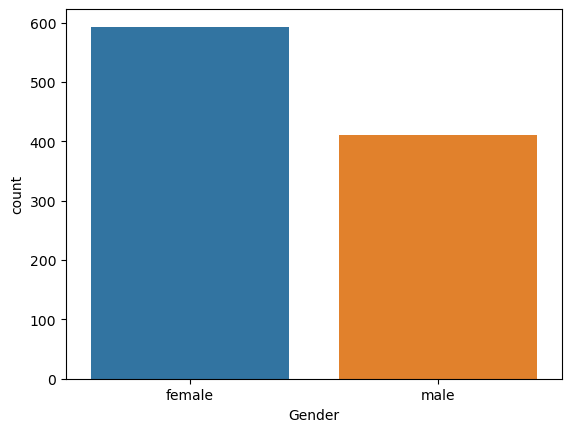

In [48]:
sns.countplot(x='Gender', data=data_project2)

<AxesSubplot:xlabel='Smoking', ylabel='count'>

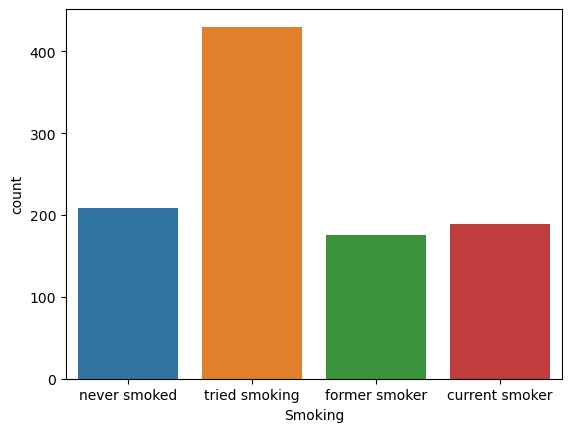

In [49]:
sns.countplot(x='Smoking', data=data_project2)

<AxesSubplot:xlabel='count', ylabel='Education'>

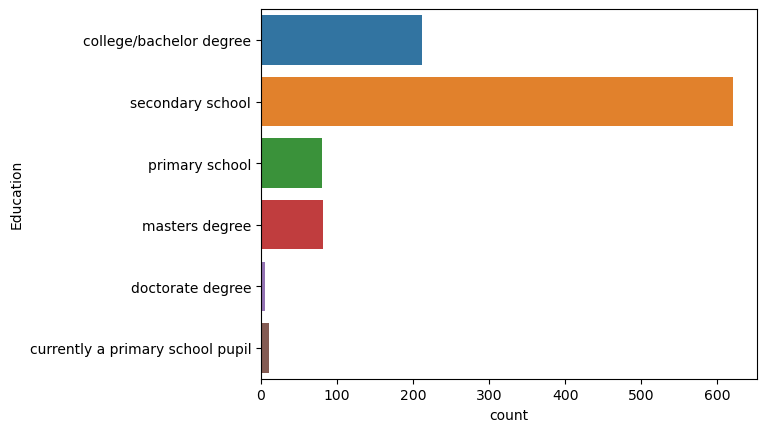

In [50]:
sns.countplot(y='Education', data=data_project2)

([0, 1, 2, 3, 4, 5],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

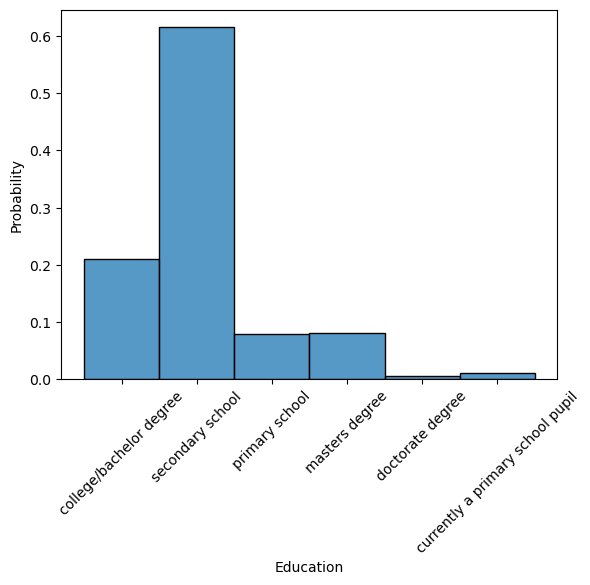

In [51]:
sns.histplot(data_project2['Education'], stat='probability')
plt.xticks(rotation=45)

([0, 1, 2, 3],
 [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

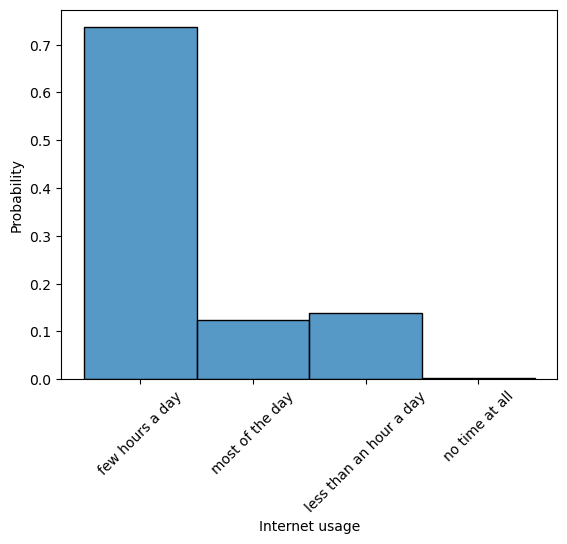

In [52]:
sns.histplot(data_project2['Internet usage'], stat='probability')
plt.xticks(rotation=45)

([0, 1, 2], [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

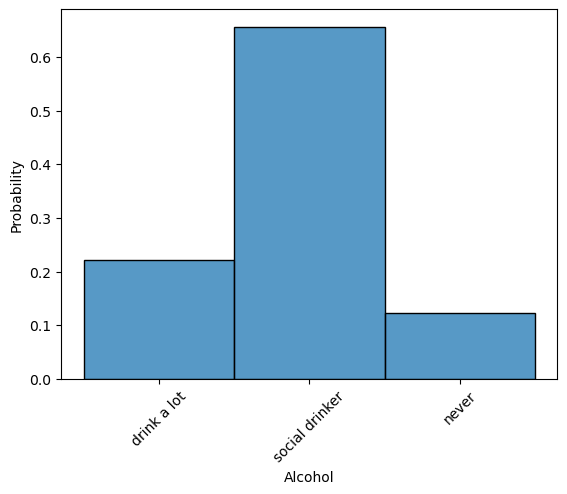

In [53]:
sns.histplot(data_project2['Alcohol'], stat='probability')
plt.xticks(rotation=45)

## Matrica korelacije

C:\Users\Legion\AppData\Local\Temp\ipykernel_18352\728409174.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  PersonalityDF.replace(['currently a primary school pupil', 'primary school', 'secondary school', 'college/bachelor degree', 'masters degree', 'doctorate degree'], [0, 1, 2, 3, 4, 5], inplace=True)


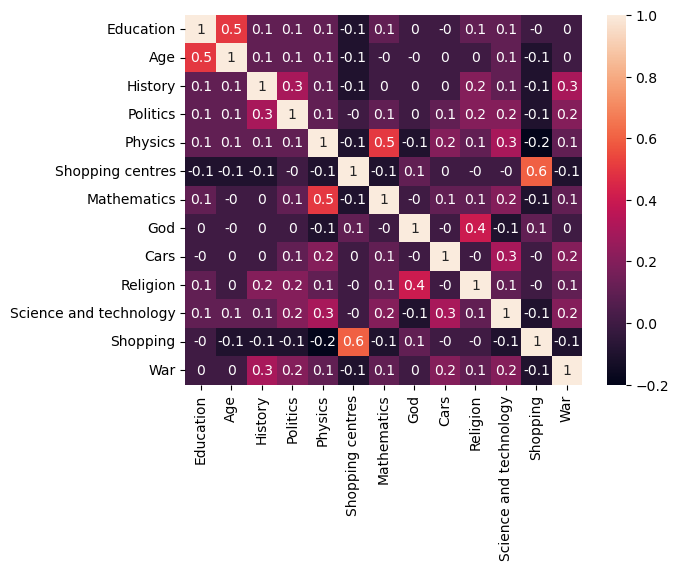

In [54]:

PersonalityDF = data_project2[['Gender', 'Education', 'Age', 'History', 'Politics', 'Physics', 'Shopping centres', 'Mathematics', 'God', 'Cars', 'Religion', 'Science and technology', 'Shopping', 'War']]
PersonalityDF.replace(['currently a primary school pupil', 'primary school', 'secondary school', 'college/bachelor degree', 'masters degree', 'doctorate degree'], [0, 1, 2, 3, 4, 5], inplace=True)

matrix = PersonalityDF._get_numeric_data().corr(method='kendall', min_periods=1).round(1)
#matrix = PersonalityDF.apply(lambda x : pd.factorize(x)[0]).corr(method='kendall', min_periods=1).round(1)

sns.heatmap(matrix, annot=True)
plt.show()

## Varijansa i standardna devijacija

In [55]:
data_project2.var(numeric_only=True).round(2).sort_values()

Personality           0.41
Music                 0.44
Dreams                0.47
Movies                0.48
Fun with friends      0.54
                     ...  
Pets                  2.39
Elections             2.48
Age                   8.00
Height              100.49
Weight              191.53
Length: 139, dtype: float64

In [56]:
data_project2.std(numeric_only=True).round(2).sort_values()

Personality          0.64
Music                0.66
Dreams               0.68
Movies               0.69
Fun with friends     0.74
                    ...  
Pets                 1.55
Elections            1.57
Age                  2.83
Height              10.02
Weight              13.84
Length: 139, dtype: float64

#### EDA analiza Projekta 2

In [57]:
project2_report = ProfileReport(data_project2)

In [58]:
project2_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### ML PROJECT 3

In [5]:
data_project3 = pd.read_csv("data/ML_Project3 - Churn_Modelling.csv")

In [60]:
data_project3.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


## Korišćenjem pandas, seaborn i matplotlib metoda

In [61]:
data_project3.describe()

,RowNumber,CustomerId,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
count,10000.00000,1.000000e+04,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000
mean,5000.50000,1.569094e+07,650.528800,38.921800,5.012800,76485.889288,1.530200,0.70550,0.515100,100090.239881,0.203700
std,2886.89568,7.193619e+04,96.653299,10.487806,2.892174,62397.405202,0.581654,0.45584,0.499797,57510.492818,0.402769
min,1.00000,1.556570e+07,350.000000,18.000000,0.000000,0.000000,1.000000,0.00000,0.000000,11.580000,0.000000
25%,2500.75000,1.562853e+07,584.000000,32.000000,3.000000,0.000000,1.000000,0.00000,0.000000,51002.110000,0.000000
50%,5000.50000,1.569074e+07,652.000000,37.000000,5.000000,97198.540000,1.000000,1.00000,1.000000,100193.915000,0.000000
75%,7500.25000,1.575323e+07,718.000000,44.000000,7.000000,127644.240000,2.000000,1.00000,1.000000,149388.247500,0.000000
max,10000.00000,1.581569e+07,850.000000,92.000000,10.000000,250898.090000,4.000000,1.00000,1.000000,199992.480000,1.000000


### Mere centralne tendencije

In [62]:
data_project3.mean(numeric_only=True).round(2)

RowNumber              5000.50
CustomerId         15690940.57
CreditScore             650.53
Age                      38.92
Tenure                    5.01
Balance               76485.89
NumOfProducts             1.53
HasCrCard                 0.71
IsActiveMember            0.52
EstimatedSalary      100090.24
Exited                    0.20
dtype: float64

In [63]:
data_project3.median(numeric_only=True).round(2)

RowNumber              5000.50
CustomerId         15690738.00
CreditScore             652.00
Age                      37.00
Tenure                    5.00
Balance               97198.54
NumOfProducts             1.00
HasCrCard                 1.00
IsActiveMember            1.00
EstimatedSalary      100193.92
Exited                    0.00
dtype: float64

In [64]:
data_project3.mode(axis=0).head(1)

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15565701,Smith,850.0,France,Male,37.0,2.0,0.0,1.0,1.0,1.0,24924.92,0.0


## Raspodela podataka

#### CreditScore atribut

<AxesSubplot:xlabel='CreditScore', ylabel='Count'>

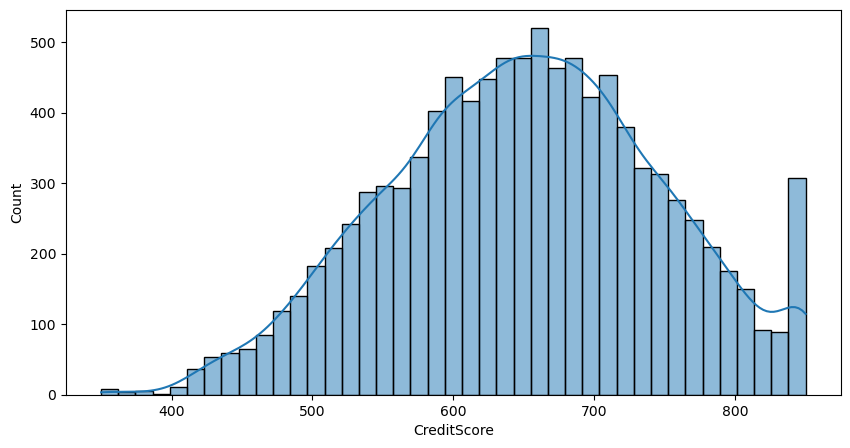

In [65]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['CreditScore'], kde=True)

<AxesSubplot:xlabel='CreditScore', ylabel='Density'>

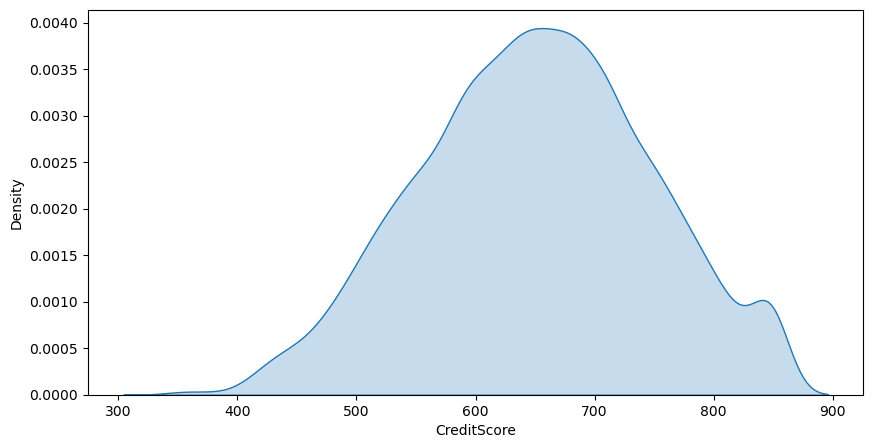

In [66]:
plt.figure(figsize=(10,5))
plt.xlabel('CreditScore')
plt.ylabel('Density')
sns.kdeplot(data_project3['CreditScore'],shade=True)

#### Age

<AxesSubplot:xlabel='Age', ylabel='Count'>

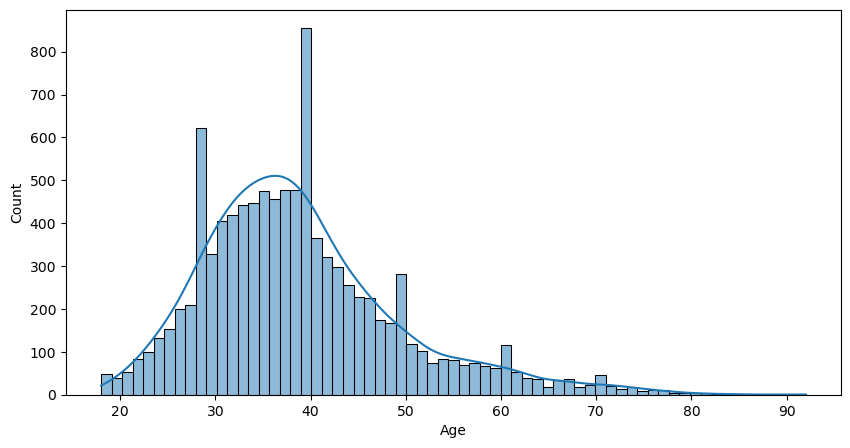

In [67]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['Age'], kde=True)

#### Tenure atribut

<AxesSubplot:xlabel='Tenure', ylabel='Count'>

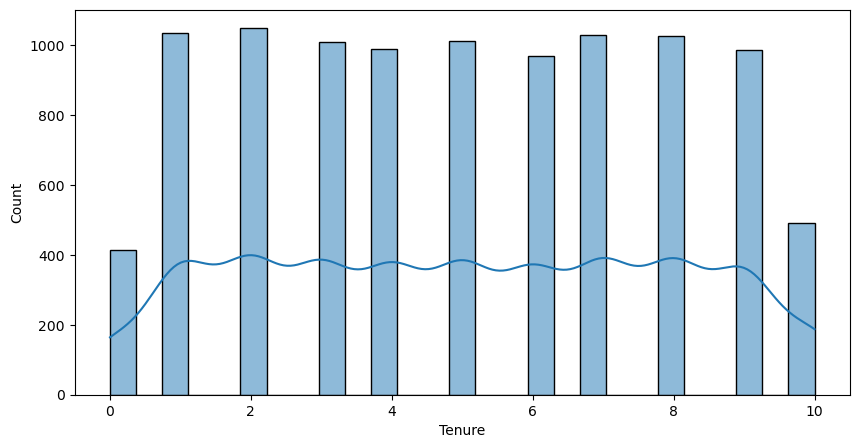

In [68]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['Tenure'], kde=True)

#### Balance atribut

<AxesSubplot:xlabel='Balance', ylabel='Count'>

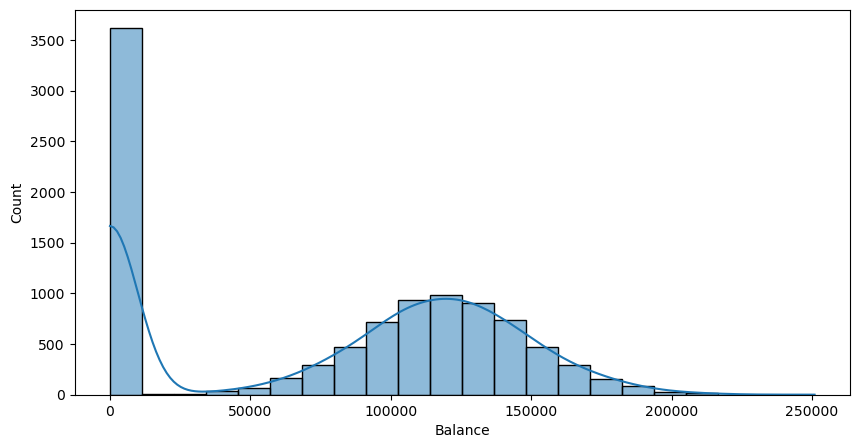

In [69]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['Balance'], kde=True)

#### Ukoliko izbacimo male vrednosti dobijamo gotovo idealni Gausovu raspodelu

<AxesSubplot:xlabel='Balance', ylabel='Count'>

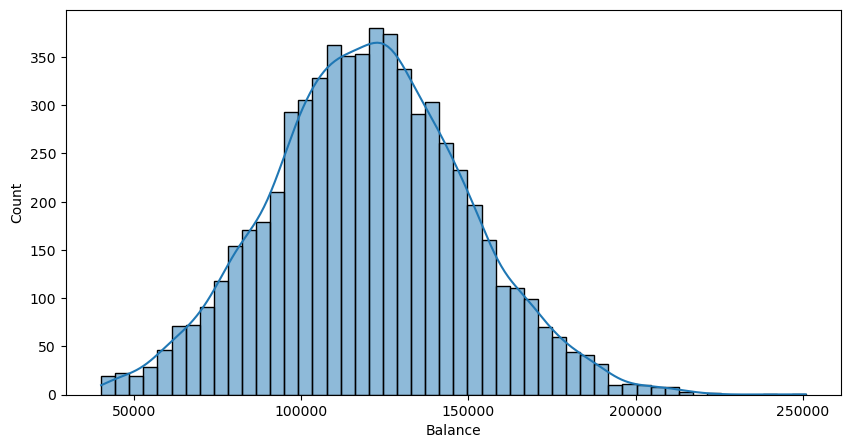

In [70]:
filtered_data_project3 = data_project3.loc[data_project3['Balance']> 40000]['Balance']

plt.figure(figsize=(10,5))
sns.histplot(filtered_data_project3, kde=True)

array([[<AxesSubplot:title={'center':'RowNumber'}>,
        <AxesSubplot:title={'center':'CustomerId'}>,
        <AxesSubplot:title={'center':'CreditScore'}>],
       [<AxesSubplot:title={'center':'Age'}>,
        <AxesSubplot:title={'center':'Tenure'}>,
        <AxesSubplot:title={'center':'Balance'}>],
       [<AxesSubplot:title={'center':'NumOfProducts'}>,
        <AxesSubplot:title={'center':'HasCrCard'}>,
        <AxesSubplot:title={'center':'IsActiveMember'}>],
       [<AxesSubplot:title={'center':'EstimatedSalary'}>,
        <AxesSubplot:title={'center':'Exited'}>, <AxesSubplot:>]],
      dtype=object)

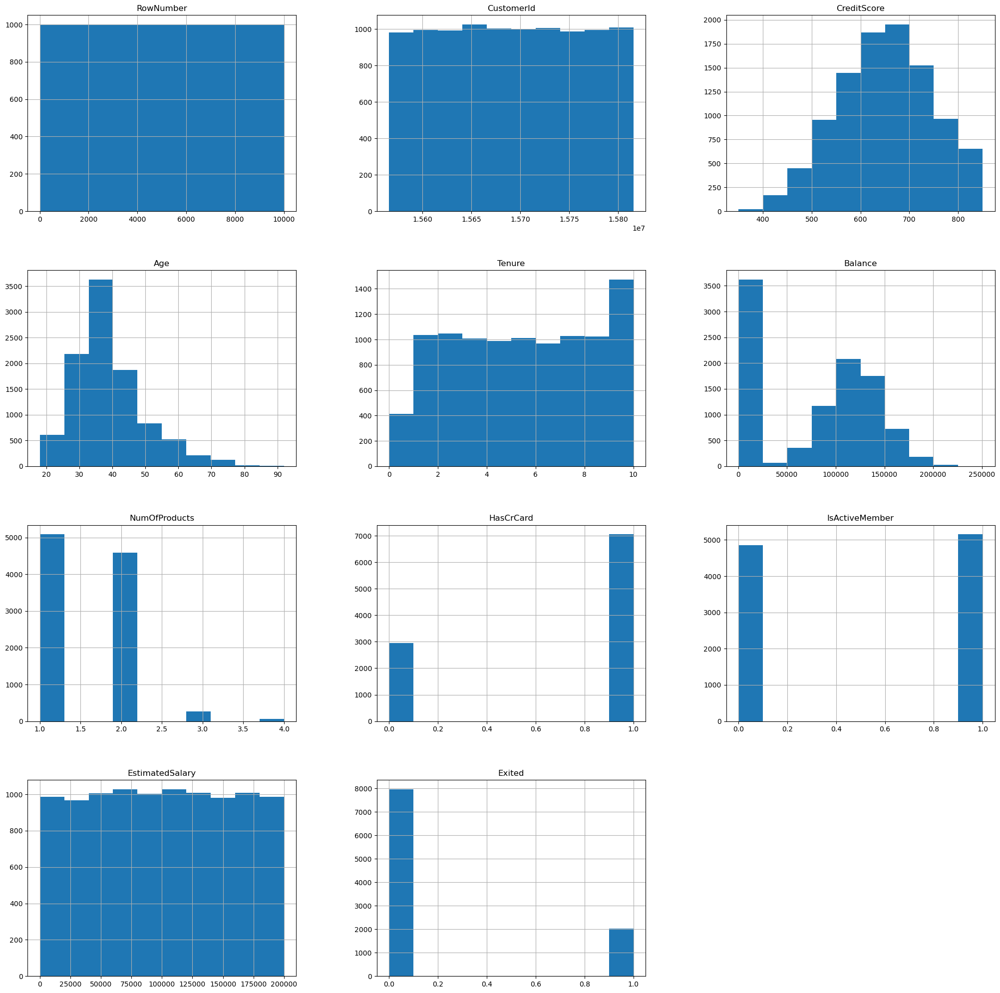

In [9]:
data_project3.hist(figsize = (25,25))


## Matrica korelacije

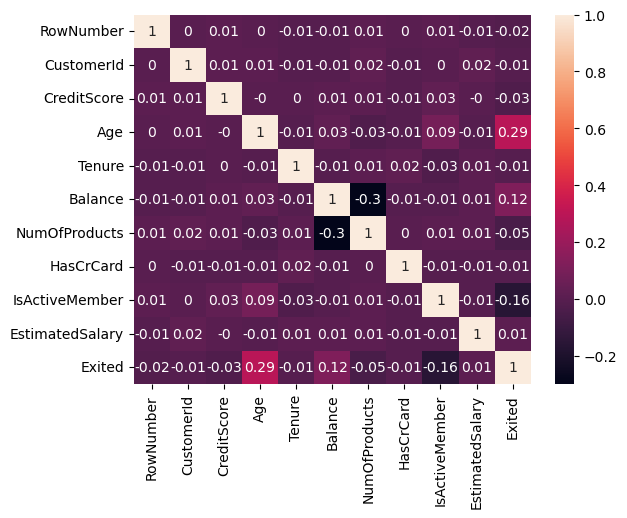

In [71]:
matrix = data_project3.corr().round(2)
sns.heatmap(matrix, annot=True)
plt.show()

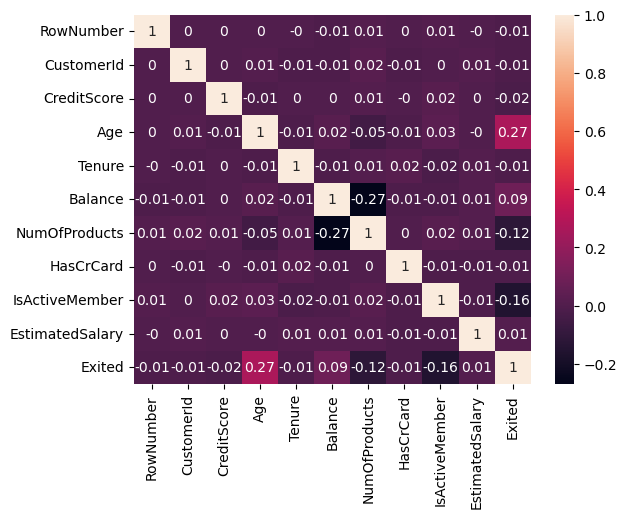

In [72]:
matrix = data_project3.corr(method='kendall').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

## Varijansa i standardna devijacija

In [73]:
data_project3.var(numeric_only=True).astype('int64')

RowNumber             8334166
CustomerId         5174814873
CreditScore              9341
Age                       109
Tenure                      8
Balance            3893436175
NumOfProducts               0
HasCrCard                   0
IsActiveMember              0
EstimatedSalary    3307456784
Exited                      0
dtype: int64

In [74]:
float(data_project3.var(numeric_only=True)['RowNumber'])

8334166.666666667

In [75]:
data_project3.std(numeric_only=True).round(2)

RowNumber           2886.90
CustomerId         71936.19
CreditScore           96.65
Age                   10.49
Tenure                 2.89
Balance            62397.41
NumOfProducts          0.58
HasCrCard              0.46
IsActiveMember         0.50
EstimatedSalary    57510.49
Exited                 0.40
dtype: float64

#### EDA analiza Projekta 3

In [76]:
project3_report = ProfileReport(data_project3)

In [77]:
project3_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### UTICAJ RASPODELE PODATAKA I ZAVISNOSTI IZMEĐU PODATAKA NA REZULTATE ALGORITAMA MAŠINSKOG UČENJA

In [6]:
data_project3.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


#### One-Hot encoding kategoričkih atributa

In [17]:
def OneHotEncode(dataset):
    OH_encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)

    columnsToEncode = ['Geography','Gender']
    OH_cols = pd.DataFrame(OH_encoder.fit_transform(dataset[columnsToEncode]))

    # One-hot encoding removed index; put it back
    OH_cols.index = dataset.index
    column_name = OH_encoder.get_feature_names_out(columnsToEncode)
    OH_cols.columns = column_name

    # Remove categorical columns (will replace with one-hot encoding)
    num_X = dataset.drop(columnsToEncode, axis=1)
    OH_X = pd.concat([num_X, OH_cols], axis=1)
    #one_hot_encoded_frame = pd.DataFrame.sparse.from_spmatrix(OH_X, columns= column_name)

    dataset=OH_X
    OH_cols = pd.DataFrame(dataset[['Exited']])
    num_X = dataset.drop("Exited", axis=1)
    Odf_X = pd.concat([num_X, OH_cols], axis=1)
    dataset=Odf_X.copy()
    return dataset

In [18]:
data_project3 = OneHotEncode(data_project3)
data_project3.head()

,RowNumber,CustomerId,Surname,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male,Exited
0,1,15634602,Hargrave,619,42,2,0.00,1,1,1,101348.88,1.0,0.0,0.0,1.0,0.0,1
1,2,15647311,Hill,608,41,1,83807.86,1,0,1,112542.58,0.0,0.0,1.0,1.0,0.0,0
2,3,15619304,Onio,502,42,8,159660.80,3,1,0,113931.57,1.0,0.0,0.0,1.0,0.0,1
3,4,15701354,Boni,699,39,1,0.00,2,0,0,93826.63,1.0,0.0,0.0,1.0,0.0,0
4,5,15737888,Mitchell,850,43,2,125510.82,1,1,1,79084.10,0.0,0.0,1.0,1.0,0.0,0


### Enkodiranje Surname atributa

In [32]:
label_encoder = preprocessing.LabelEncoder()

data_project3['Surname']= label_encoder.fit_transform(data_project3['Surname'])

### Matrica korelacije enkodiranih podataka

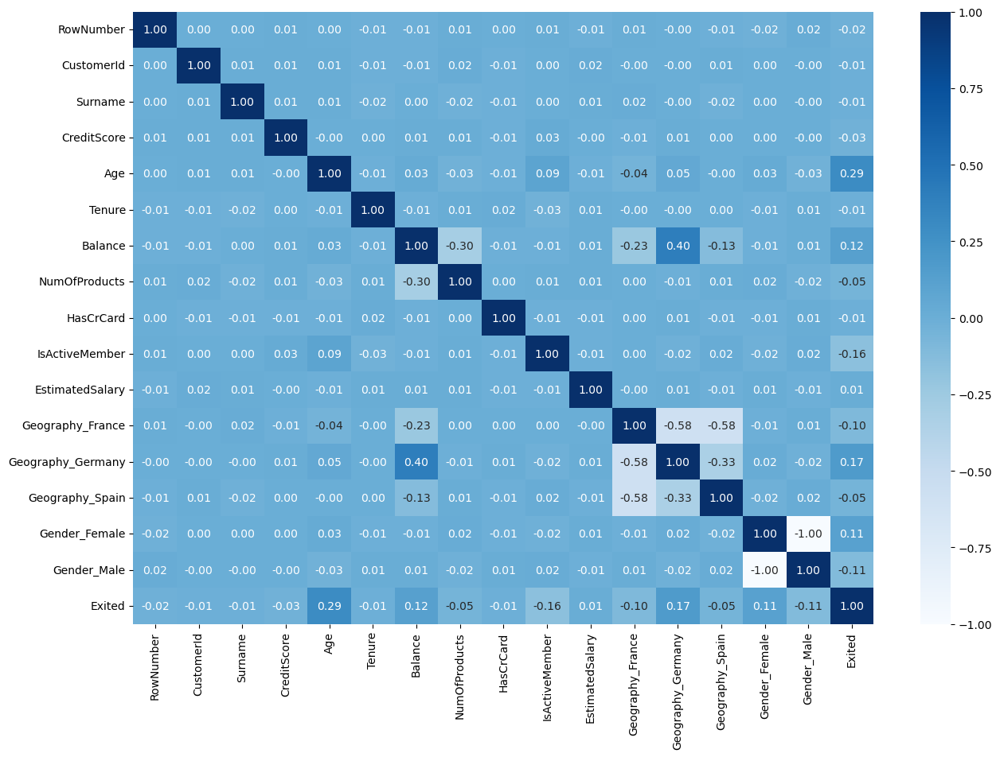

In [33]:
# matrix = data_project3.corr().round(2)
# sns.heatmap(matrix, annot=True)
# plt.show()

fig, ax = plt.subplots(figsize=(15,10))   
sns.heatmap(data_project3.corr().round(2), annot = True , fmt=".2f",ax=ax ,cmap = "Blues")
plt.show()

### Skaliranje podataka

In [26]:
def ScaleColumns(dataset):
    columnsForScaling = ["CreditScore", "Age", "Tenure", "Balance", "EstimatedSalary"]
    for columnForScaling in columnsForScaling:
        dataset[columnForScaling] = (dataset[columnForScaling] - np.min(dataset[columnForScaling])) / \
            (np.max(dataset[columnForScaling])-np.min(dataset[columnForScaling]))
    return dataset

In [34]:
data_project3_Scaled = ScaleColumns(data_project3)
data_project3_Scaled.head()

,RowNumber,CustomerId,Surname,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male,Exited
0,1,15634602,1115,0.538,0.324324,0.2,0.000000,1,1,1,0.506735,1.0,0.0,0.0,1.0,0.0,1
1,2,15647311,1177,0.516,0.310811,0.1,0.334031,1,0,1,0.562709,0.0,0.0,1.0,1.0,0.0,0
2,3,15619304,2040,0.304,0.324324,0.8,0.636357,3,1,0,0.569654,1.0,0.0,0.0,1.0,0.0,1
3,4,15701354,289,0.698,0.283784,0.1,0.000000,2,0,0,0.469120,1.0,0.0,0.0,1.0,0.0,0
4,5,15737888,1822,1.000,0.337838,0.2,0.500246,1,1,1,0.395400,0.0,0.0,1.0,1.0,0.0,0


### Balansiranje skupa podataka

In [40]:
less = len(data_project3_Scaled[data_project3_Scaled['Exited'] == 1])
more = len(data_project3_Scaled[data_project3_Scaled['Exited'] == 0])
class_distribution_ration = less/more
x = data_project3_Scaled.drop(["Exited"], axis = 1)
y = data_project3_Scaled["Exited"]

#Transformacija dataset-a
# oversampling
oversample = SMOTE()
X, Y = oversample.fit_resample(x, y)

frames = [X, Y]
data_project3_finished = pd.concat(frames, axis=1, join='inner')



In [41]:
data_project3_finished.head()

,RowNumber,CustomerId,Surname,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male,Exited
0,1,15634602,1115,0.538,0.324324,0.2,0.000000,1,1,1,0.506735,1.0,0.0,0.0,1.0,0.0,1
1,2,15647311,1177,0.516,0.310811,0.1,0.334031,1,0,1,0.562709,0.0,0.0,1.0,1.0,0.0,0
2,3,15619304,2040,0.304,0.324324,0.8,0.636357,3,1,0,0.569654,1.0,0.0,0.0,1.0,0.0,1
3,4,15701354,289,0.698,0.283784,0.1,0.000000,2,0,0,0.469120,1.0,0.0,0.0,1.0,0.0,0
4,5,15737888,1822,1.000,0.337838,0.2,0.500246,1,1,1,0.395400,0.0,0.0,1.0,1.0,0.0,0


### Kreiranje filtiriranog skupa podataka

In [53]:
data_project3_filtered = data_project3_finished.copy()
data_project3_filtered.head()

,RowNumber,CustomerId,Surname,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male,Exited
0,1,15634602,1115,0.538,0.324324,0.2,0.000000,1,1,1,0.506735,1.0,0.0,0.0,1.0,0.0,1
1,2,15647311,1177,0.516,0.310811,0.1,0.334031,1,0,1,0.562709,0.0,0.0,1.0,1.0,0.0,0
2,3,15619304,2040,0.304,0.324324,0.8,0.636357,3,1,0,0.569654,1.0,0.0,0.0,1.0,0.0,1
3,4,15701354,289,0.698,0.283784,0.1,0.000000,2,0,0,0.469120,1.0,0.0,0.0,1.0,0.0,0
4,5,15737888,1822,1.000,0.337838,0.2,0.500246,1,1,1,0.395400,0.0,0.0,1.0,1.0,0.0,0


#### Na osnovu matrice korelacije možemo izbaciti sledeće atribute

In [54]:
data_project3_filtered.drop(["RowNumber","CustomerId","Surname", "Tenure", "HasCrCard", "EstimatedSalary", "Age"], axis=1, inplace = True)

In [55]:
data_project3_filtered.head()

,CreditScore,Balance,NumOfProducts,IsActiveMember,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male,Exited
0,0.538,0.000000,1,1,1.0,0.0,0.0,1.0,0.0,1
1,0.516,0.334031,1,1,0.0,0.0,1.0,1.0,0.0,0
2,0.304,0.636357,3,0,1.0,0.0,0.0,1.0,0.0,1
3,0.698,0.000000,2,0,1.0,0.0,0.0,1.0,0.0,0
4,1.000,0.500246,1,1,0.0,0.0,1.0,1.0,0.0,0


### Podela na Train/Test skupove podataka

In [56]:
X_finished = data_project3_finished.drop("Exited", axis=1).values
y_finished = data_project3_finished["Exited"].values

X_train_finished , X_test_finished, y_train_finished, y_test_finished = train_test_split(X_finished, y_finished, test_size = 0.2, random_state = 1)


In [74]:
print(X_train_finished.shape)
print(X_test_finished.shape)
print(y_train_finished.shape)
print(y_test_finished.shape)

(12740, 16)
(3186, 16)
(12740,)
(3186,)


In [57]:
X_filtered = data_project3_filtered.drop("Exited", axis=1).values
y_filtered = data_project3_filtered["Exited"].values

X_train_filtered ,X_test_filtered, y_train_filtered, y_test_filtered = train_test_split(X_filtered, y_filtered, test_size = 0.2, random_state = 1)


### Funkcija za procenu uspešnosti

In [47]:

def eval_model(y_true_, y_pred_):
    accuracy = accuracy_score(y_true_, y_pred_)
    f1 = f1_score(y_true_, y_pred_)
    precision = precision_score(y_true_, y_pred_)
    recall = recall_score(y_true_, y_pred_)
    conf_matrix = confusion_matrix(y_true=y_true_, y_pred=y_pred_)
    TN, FP, FN, TP = conf_matrix.ravel()
    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)

    print("Accuracy : ", accuracy)
    print("F1 Score: ", f1)
    print("Precision: ", precision)
    print("Recall: ", recall)
    print("Confuse matrix:")
    print(conf_matrix)
    print("True positive: ", TP)
    print("False positive: ", FP)
    print("True negative: ", TN)
    print("False negative: ", FN)
    print("Sensitivity: ", sensitivity)
    print("Specificity: ", specificity)

In [68]:
def plot_conf_matrix(matrix):
    class_names=['N','P']

    # Create pandas dataframe
    dataframe = pd.DataFrame(matrix, index=class_names, columns=class_names)

    # Create heatmap
    sns.heatmap(dataframe, annot=True, cbar=None, fmt = ".1f", cmap="Blues")
    plt.title("Confusion Matrix"), plt.tight_layout()
    plt.ylabel("True Class"), plt.xlabel("Predicted Class")
    plt.show()

#### Ceo skup podataka

[0.84557439 0.83866918 0.85812932 0.83427495 0.83741368 0.83615819
 0.83165829 0.83040201 0.85552764 0.81972362]
Mean:  0.8387531269025604
(3186, 16)
(3186,)


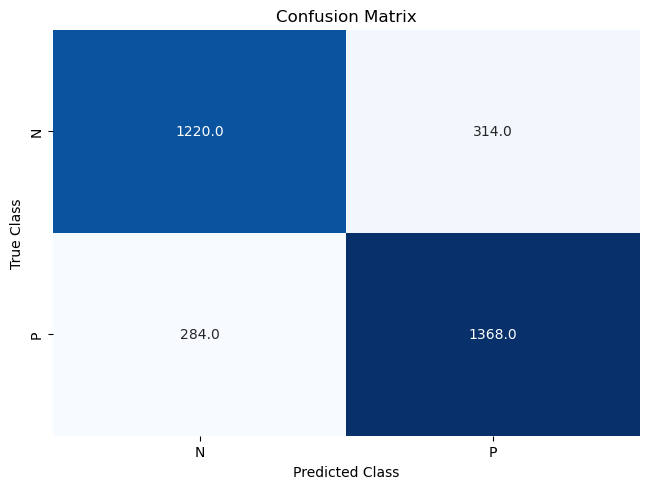

Accuracy :  0.8336472065285625
F1 Score:  0.8421679571173318
Precision:  0.8288393903868698
Recall:  0.8559322033898306
Confuse matrix:
[[1242  292]
 [ 238 1414]]
True positive:  1414
False positive:  292
True negative:  1242
False negative:  238
Sensitivity:  0.8559322033898306
Specificity:  0.8096479791395046


In [77]:
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import StratifiedKFold, cross_val_score, cross_val_predict

scaler = StandardScaler()
dt_classifier = DecisionTreeClassifier(random_state=0)

pipeline = make_pipeline(scaler, dt_classifier)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
dt_cv_results_finished = cross_val_score(pipeline, X_finished, y_finished, cv=kf, scoring="accuracy", n_jobs=-1)

print(dt_cv_results_finished)
print("Mean: ", dt_cv_results_finished.mean())

print(X_test_finished.shape)
print(y_test_finished.shape)

y_pred = cross_val_predict(pipeline, X_test_finished, y_test_finished, cv=10)
conf_mat = confusion_matrix(y_test_finished, y_pred)


plot_conf_matrix(conf_mat)


pipeline.fit(X_train_finished, y_train_finished)

rs_prediction_finished = pipeline.predict(X_test_finished)

# model evaluation
eval_model(y_test_finished, rs_prediction_finished)

#### Filtrirani skup podataka

[0.8349027  0.82109228 0.81607031 0.81607031 0.80225989 0.80979284
 0.80590452 0.79962312 0.79522613 0.83165829]
Mean:  0.8132600384218645


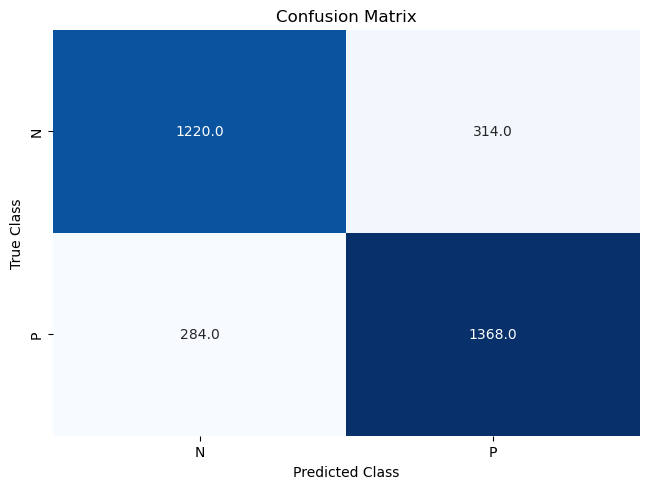

Accuracy :  0.8035153797865662
F1 Score:  0.8085626911314985
Precision:  0.8170580964153276
Recall:  0.8002421307506054
Confuse matrix:
[[1238  296]
 [ 330 1322]]
True positive:  1322
False positive:  296
True negative:  1238
False negative:  330
Sensitivity:  0.8002421307506054
Specificity:  0.8070404172099087


In [78]:
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import StratifiedKFold, cross_val_score

scaler = StandardScaler()
dt_classifier = DecisionTreeClassifier(random_state=0)

pipeline = make_pipeline(scaler, dt_classifier)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
dt_cv_results_filtered = cross_val_score(pipeline, X_filtered, y_filtered, cv=kf, scoring="accuracy", n_jobs=-1)

print(dt_cv_results_filtered)
print("Mean: ", dt_cv_results_filtered.mean())

y_pred_filtered = cross_val_predict(pipeline, X_test_filtered, y_test_filtered, cv=10)
conf_mat_filtered = confusion_matrix(y_test_filtered, y_pred)

plot_conf_matrix(conf_mat_filtered)

pipeline.fit(X_train_filtered, y_train_filtered)

rs_prediction_filtered = pipeline.predict(X_test_filtered)

# model evaluation
eval_model(y_test_filtered, rs_prediction_filtered)

# ZAKLJUČAK

Prema gore pokazanim primerima raspodele podataka i izračunavanjima različitih vrednosti kvaliteta podataka, neophodno je napomenuti sledeće zaključke: 


1) Na osnovu pozicioniranja krive prilikom procesa RASPODELE PODATAKA moguće je otkriti i pronaći "outlier" vrednosti u podacima. OUTLIER vrednosti predstavljaju vrednosti koje odstupaju od opsega većine podataka i sa njima se treba vrlo pažljivo rukovati kako bi se kreirani model mašinskog učenja što bolje prilagodio domenu problema koji se rešava. 

    - OUTLIER vrednosti mogu predstavljati pogrešne vrednosti koje negativno utiču na uspešnost predikcije modela mašinskog učenja pri čemu:
        
        - kod KLASIFIKACIJE utiču smanjivanjem verovatnoće preciznosti predikcije samog objekta nad kojim se vrši predikcija i time smanjuje uspešnost samog algoritma
        
        - kod REGRESIJE negativno utiču na tačnost i pouzdanost modela prilikom određivanja regresione linije koja treba najbolje opisati relacije između zavisnih i nezavisnih promenljivih. Obzirom da  su ove "outlier" vrednosti  udaljene od ostalih podataka, to značajno utiče na nepravilnu prilagođenost regresione krive samim posmatranim podacima. Kako bismo ovakvo negativno prilagođavanje otklonili, neophodno je pre same faze treniranja modela ukloniti "outlier" vrednosti ili primeniti regresione metode koje su manje osetljive na te vrednosti

2) Na osnovu MATRICE KORELACIJE možemo doneti sledeće zaključke:
    
    - Obzirom da korelacija predstavlja meru uslovljenosti promene vrednosti između dva atributa u posmatranom skupu podataka, možemo jasno uočiti koji atributi jesu, a koji atributi nisu zavisni od ostalih. Imajući u obzir zavisnosti u podacima, jasno se može utvrditi da slabo uslovljeni atributi ne utiču na konačnu vrednost zavisnosti izlaznog podatka i da je takve podatke moguće izbaciti. Zavisne atribute je poželjno uključiti u skup podataka koji se koristi za treniranje modela mašinskog učenja jer se izlazna vrednost modela treba utvrditi na osnovu većeg broja zavisnih atributa koji modeluju takav izlaz 
    
3) Na osnovu VREDNOSTI VARIJANSE možemo doneti sledeće zaključke:

    - Kako vrednost varijanse raznih atributa može imati različite opsege vrednosti, a obzirom da se ta vrednost drastično razlikuje od ostalih vrednosti varijanse atributa, najpre je neophodno izvršiti analizu varijanse svakog pojedinačnog atributa. Ukoliko je vrednost varijanse veoma niska, takvi atributi ne predstavljaju kvalitetan atribut na osnovu kojeg se može doneti određena zakonitost o promeni zavisnih vrednosti. Ukoliko je vrednost varijanse veoma visoka, može doći do Overfitting-a što predstavlja preveliko prilagođavanje vrednostima iz skupa sa velikom varijansom. Prilikom overfitting-a, model se previše prilagođava podacima za koje je treniran, pri čemu se ne može dobro generalizovati i primeniti nad novim podacima. Ukoliko nemamo dovoljnu količinu dostupnih podataka, a imamo visok šum ili varijaciju u tim podacima, dolazi do pretreniranosti modela i do donošenja neispravnih zaključaka prilikom primene tog modela nad novim ulaznim podacima.